In [1]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

In [2]:
df = pd.read_csv("train_action_history.csv")
print("Shape of the dataset :",df.shape)
df.head()

Shape of the dataset : (8797911, 8)


,customer_code,Offer_id,Offer_subid,batch_id,product_category,product_sub_category,send_timestamp,open_timestamp
0,00199d3467a7191db5bfa4e5f9a62eeb96fb0b602c3ec5...,AC_100044882,VR_200098111,70000078,CC_ACQ_SECURED,SECURED_ACQ,2024-10-22T17:35:27.000Z,NaN
1,001f2abab1bccc25d00bba68fea57a81cab1c76d485515...,AC_100048426,VR_200108485,10000253,SIP / MF,ACQUISITION,2024-08-09T18:20:18.000Z,NaN
2,00298fc11fb6924004c041f141f92c3c74e209d9a737d9...,AC_100052603,VR_200127708,70000074,CC_INORGANIC,EMI,2024-09-20T10:45:20.000Z,2024-09-20T10:45:31.000Z
3,0038a46221c0175fc8938ebc8aef8d0f83b3ac1ad84662...,AC_100047006,VR_200105035,70000072,CC_ACQ_SECURED,SECURED_ACQ,2024-09-06T12:37:16.000Z,NaN
4,00409395a831af7fd41d0ec70a5be3bda13d64cb3e4be9...,AC_100046122,VR_200100845,10000246,RURAL,BALANCE BUILD UP,2024-06-23T11:03:13.000Z,NaN


In [3]:
df['open_timestamp'].isna().sum()

np.int64(6190066)

In [4]:
all_nan_cols = df.columns[df.isna().all()]

print(all_nan_cols)

Index([], dtype='object')


In [3]:
df = df.dropna(subset=['open_timestamp'])

In [6]:
df.shape

(2607845, 8)

In [7]:
de = pd.read_csv("customer_features.csv")
print("Shape of the dataset :",de.shape)
de.head()

Shape of the dataset : (220656, 304)


,Unnamed: 0,customer_code,v2,v3,v4,v5,v6,v7,v8,v9,...,v294,v295,v296,v297,v298,v299,v300,v301,v302,batch_date
0,437535,00006eb623a7a335fb6fa7334939cca08c75e80e44e404...,40-44,NaN,NaN,99,NORTH WEST DELHI,95013,NaN,IN,...,215,72,232,178,101,299,192,198,274,2024-10-25 00:00:00+00:00
1,203786,000095ace79862eb5f4481723b8757b8637ba7ab5caeea...,20-24,NaN,NaN,NaN,MATHURA,NaN,NaN,INDIA,...,215,72,232,178,101,299,192,198,274,2024-10-25 00:00:00+00:00
2,813116,0000b7d57830b87a5049eca606772266fc83c60e690fb4...,45-49,NaN,NaN,99,THANE,95013,NaN,INDIA,...,215,72,232,178,101,299,192,198,274,2024-10-25 00:00:00+00:00
3,100966,0000b844339117db33d8dcc6ca4e97a8c989a918c8cf01...,20-24,NaN,NaN,NaN,GAUTAM BUDDHA NAGAR,NaN,NaN,INDIA,...,215,72,232,178,101,299,192,198,274,2024-10-25 00:00:00+00:00
4,825430,0000d719d7706b7164235a7c7dc4a1954799eff90fb622...,45-49,NaN,NaN,ZZ,CHANDAULI,ZZ,NaN,INDIA,...,215,72,232,178,101,299,192,198,274,2024-10-25 00:00:00+00:00


In [8]:
all_nan_cols = de.columns[de.isna().all()]

print(all_nan_cols)

Index(['v3', 'v4', 'v21', 'v22', 'v23', 'v25', 'v26', 'v76', 'v78', 'v149',
       'v150', 'v151', 'v152', 'v153', 'v154', 'v214', 'v221', 'v242', 'v245',
       'v246', 'v247', 'v248', 'v249', 'v250', 'v251'],
      dtype='object')


In [9]:
de['batch_date'] = pd.to_datetime(de['batch_date'], utc=True)  
df['send_timestamp'] = pd.to_datetime(df['send_timestamp'], utc=True)

In [10]:
merged = pd.merge(de, df, on="customer_code", how="inner")

In [11]:
filtered_data = merged[merged['batch_date'] <= merged['send_timestamp']]

In [12]:
filtered_data_final = filtered_data.loc[
    filtered_data.groupby('customer_code')['batch_date'].idxmax()
]

In [13]:
print("Shape of the filtered data:", filtered_data_final.shape)

Shape of the filtered data: (139153, 311)


In [14]:
filtered_data_final.head()

,Unnamed: 0,customer_code,v2,v3,v4,v5,v6,v7,v8,v9,...,v301,v302,batch_date,Offer_id,Offer_subid,batch_id,product_category,product_sub_category,send_timestamp,open_timestamp
0,437535,00006eb623a7a335fb6fa7334939cca08c75e80e44e404...,40-44,NaN,NaN,99,NORTH WEST DELHI,95013,NaN,IN,...,198,274,2024-10-25 00:00:00+00:00,AC_100053735,VR_200135492,50080084,CC_SPENDS,PORTFOLIO,2024-10-26 17:11:02+00:00,2024-10-26T22:58:42.000Z
16,813116,0000b7d57830b87a5049eca606772266fc83c60e690fb4...,45-49,NaN,NaN,99,THANE,95013,NaN,INDIA,...,198,274,2024-10-25 00:00:00+00:00,AC_100003681,VR_200008007,20000225,PL X-SELL,CROSS SELL PL,2024-10-31 09:04:34+00:00,2024-10-31T10:38:05.000Z
36,100966,0000b844339117db33d8dcc6ca4e97a8c989a918c8cf01...,20-24,NaN,NaN,NaN,GAUTAM BUDDHA NAGAR,NaN,NaN,INDIA,...,198,274,2024-10-25 00:00:00+00:00,AC_100044882,VR_200094434,70000079,CC_ACQ_SECURED,SECURED_ACQ,2024-10-26 16:02:14+00:00,2024-10-26T16:02:23.000Z
93,205815,0000e207ade14cecf5fb2ff0029e1594cba1db1776e24f...,30-34,NaN,NaN,99,ERNAKULAM,99999,NaN,INDIA,...,198,274,2024-10-25 00:00:00+00:00,AC_100046160,VR_200114442,20000244,SAVINGS,TURBO-SA XSELL,2024-11-28 14:27:19+00:00,2024-11-28T16:36:37.000Z
97,178004,000103fc5e7c53d7f212ceeed6d8470a5db39fbb67785f...,35-39,NaN,NaN,NaN,Y.S.R.,NaN,NaN,INDIA,...,198,274,2024-10-25 00:00:00+00:00,AC_100045145,VR_200096042,166339,CC_ACTIVATION,30D_ACTIVATION,2024-11-12 14:10:26+00:00,2024-11-12T21:29:57.000Z


In [15]:
# Ensure timestamps are in datetime format
filtered_data_final['send_timestamp'] = pd.to_datetime(filtered_data_final['send_timestamp'], errors='coerce')
filtered_data_final['open_timestamp'] = pd.to_datetime(filtered_data_final['open_timestamp'], errors='coerce')

In [16]:
def calculate_slot(timestamp):
    if pd.isna(timestamp):
        return np.nan
    # Extract the hour and weekday
    hour = timestamp.hour
    day = timestamp.dayofweek  # Monday = 0, Sunday = 6
    # Determine the slot index
    slot_index = day * 4 + (hour - 9) // 3 + 1
    return f"slot_{slot_index}" if 1 <= slot_index <= 28 else np.nan

In [17]:
filtered_data_final['send_slot'] = filtered_data_final['send_timestamp'].apply(calculate_slot)
filtered_data_final['open_slot'] = filtered_data_final['open_timestamp'].apply(calculate_slot)

In [18]:
print(filtered_data_final[['send_slot', 'open_slot']].head())

   send_slot open_slot
0    slot_23   slot_25
16   slot_13   slot_13
36   slot_23   slot_23
93   slot_14   slot_15
97    slot_6    slot_9


In [19]:
engaged_data = filtered_data_final[~filtered_data_final['open_slot'].isna()]

In [20]:
filtered_data_final.shape

(139153, 313)

In [21]:
engaged_data.shape

(135002, 313)

In [22]:
engaged_data.value_counts('open_slot')

open_slot
slot_23    7126
slot_19    6110
slot_18    5836
slot_24    5829
slot_16    5620
slot_15    5591
slot_17    5400
slot_14    5370
slot_21    5268
slot_20    5256
slot_4     5131
slot_3     5049
slot_11    4962
slot_2     4889
slot_25    4885
slot_22    4715
slot_5     4584
slot_7     4555
slot_6     4548
slot_9     4404
slot_13    4329
slot_12    4273
slot_8     4165
slot_10    3867
slot_27    3762
slot_26    3425
slot_1     3049
slot_28    3004
Name: count, dtype: int64

In [22]:
X = engaged_data.drop(columns=['Unnamed: 0', 'open_slot', 'customer_code'])  # Features
y = engaged_data['open_slot']

In [23]:
# Extract useful components from datetime columns
X['send_hour'] = X['send_timestamp'].dt.hour
X['send_day'] = X['send_timestamp'].dt.day
X['send_weekday'] = X['send_timestamp'].dt.weekday

X['open_hour'] = X['open_timestamp'].dt.hour
X['open_day'] = X['open_timestamp'].dt.day
X['open_weekday'] = X['open_timestamp'].dt.weekday

X['batch_hour'] = X['batch_date'].dt.hour
X['batch_day'] = X['batch_date'].dt.day
X['batch_weekday'] = X['batch_date'].dt.weekday

# Drop the original datetime columns if not needed
X = X.drop(columns=['send_timestamp', 'open_timestamp', 'batch_date'])

In [24]:
non_numeric_columns = X.select_dtypes(include=['object']).columns
print("Non-numeric columns:", non_numeric_columns)

Non-numeric columns: Index(['v2', 'v5', 'v6', 'v7', 'v8', 'v9', 'v10', 'v11', 'v13', 'v14', 'v15',
       'v16', 'v17', 'v18', 'v19', 'v20', 'v27', 'v29', 'v30', 'v31', 'v33',
       'v34', 'v35', 'v36', 'v37', 'v38', 'v42', 'v43', 'v46', 'v47', 'v48',
       'v54', 'v55', 'v56', 'v57', 'v58', 'v59', 'v60', 'v61', 'v63', 'v64',
       'v66', 'v67', 'v68', 'v69', 'v70', 'v71', 'v72', 'v73', 'v74', 'v75',
       'v81', 'v99', 'v101', 'v102', 'v103', 'v222', 'v223', 'v229', 'v230',
       'v271', 'v272', 'v273', 'v274', 'v275', 'v276', 'v277', 'v278', 'v279',
       'v280', 'v281', 'v282', 'v283', 'v284', 'v285', 'v286', 'Offer_id',
       'Offer_subid', 'product_category', 'product_sub_category', 'send_slot'],
      dtype='object')


In [25]:
for col in non_numeric_columns:
    print(f"Column: {col}")
    print(X[col].unique())
    print(X[col].dtype)

Column: v2
['40-44' '45-49' '20-24' '30-34' '35-39' '75-79' '25-29' '70-74' '60-64'
 '55-59' '80-84' '50-54' nan '65-69' '10-14' '15-19' '0-4' '5-9' '85-89'
 '90-94' '95-99' '100-104']
object
Column: v5
['99' nan 'ZZ' '31' '05' '45' '42' '41' '11' '5' '49' '32' '12' '19' '33'
 '6' '51' '3' '02' '4' '39' '1' '10']
object
Column: v6
['NORTH WEST DELHI' 'THANE' 'GAUTAM BUDDHA NAGAR' ... 'JALDA' 'SUNEL'
 'MUSSAFAH']
object
Column: v7
['95013' nan '99999' 'ZZ' '95019' '95012' '04' '01' '95002' '93001'
 '51909' '93002' '22101' '95014' '51303' '95003' '85101' '1159A' '74101'
 '05001' '91101' '01101' '93109' '51302' '52319' '17209' '60204' '95011'
 '52101' '01103' '74301' '93003' '01157' '51406' '02' '60201' '52313'
 '01201' '85102' '29202' '27101' '66002' '05' '51101' '65929' '15' '06'
 '74201' '33101' '11' '51204' '03' '28101B' '52201' '01202' '50002'
 '27201' '93101' '55101' '63001' '52312' '21001' '51502' '27301' '28901'
 '15409' '15303' '01108' '26101' '63013' '70001' '40101O' '75001' '45

In [26]:
label_encoder = LabelEncoder()
for col in non_numeric_columns:
    X[col] = X[col].astype(str)
    X[col] = label_encoder.fit_transform(X[col])

In [27]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

In [28]:
X = X.fillna(X.mean())

In [29]:
np.isnan(X)

,v2,v3,v4,v5,v6,v7,v8,v9,v10,v11,...,send_slot,send_hour,send_day,send_weekday,open_hour,open_day,open_weekday,batch_hour,batch_day,batch_weekday
0,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
16,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
36,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
93,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
97,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2606389,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2606415,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2606430,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2606442,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [30]:
X = X.drop(columns=['v3', 'v4', 'v8', 'v12', 'v13', 'v14', 'v21', 'v22', 'v23', 'v25',
       'v26', 'v28', 'v57', 'v70', 'v75', 'v76', 'v78', 'v149', 'v150', 'v151',
       'v152', 'v153', 'v154', 'v214', 'v221', 'v242', 'v245', 'v246', 'v247',
       'v248', 'v249', 'v250', 'v251'])

In [31]:
np.isnan(X)

,v2,v5,v6,v7,v9,v10,v11,v15,v16,v17,...,send_slot,send_hour,send_day,send_weekday,open_hour,open_day,open_weekday,batch_hour,batch_day,batch_weekday
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
16,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
36,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
93,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
97,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2606389,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2606415,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2606430,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2606442,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, stratify=y_encoded, test_size=0.2, random_state=42)

In [33]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [34]:
print(y_train.shape)

(108001,)


In [35]:
import tensorflow as tf
tf.random.set_seed(3)
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import to_categorical
from keras.layers import Dropout
from keras.optimizers import Adam

In [36]:
y_encoded

array([17,  4, 15, ..., 16, 11,  6])

In [37]:
y_train = to_categorical(y_train, num_classes=28)
y_test = to_categorical(y_test, num_classes=28)

In [38]:
print(y_train[:10])

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0.]]


In [39]:
X_train.shape

(108001, 283)

In [40]:
y_train.shape

(108001, 28)

In [41]:
X_test.shape

(27001, 283)

In [42]:
y_test.shape

(27001, 28)

In [43]:
model = Sequential()
model.add(Dense(512, activation='relu', input_dim=X_train.shape[1]))
model.add(Dropout(0.2))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(28, activation='softmax'))

In [44]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [45]:
from keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping])

Epoch 1/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 22s 7ms/step - accuracy: 0.0969 - loss: 3.1492 - val_accuracy: 0.2860 - val_loss: 2.1955
Epoch 2/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 20s 7ms/step - accuracy: 0.2514 - loss: 2.2005 - val_accuracy: 0.3936 - val_loss: 1.7414
Epoch 3/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 18s 7ms/step - accuracy: 0.3465 - loss: 1.8058 - val_accuracy: 0.5499 - val_loss: 1.3210
Epoch 4/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 17s 6ms/step - accuracy: 0.4896 - loss: 1.3927 - val_accuracy: 0.7266 - val_loss: 0.8967
Epoch 5/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 15s 5ms/step - accuracy: 0.6381 - loss: 1.0125 - val_accuracy: 0.8375 - val_loss: 0.6072
Epoch 6/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - accuracy: 0.7358 - loss: 0.7508 - val_accuracy: 0.9032 - val_loss: 0.4143
Epoch 7/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 13s 5ms/step - accuracy: 0.8006 - loss: 0.5615 - val_accuracy: 0.9355 - val_loss: 0.2960
Epoch 8/50
2700/2700 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - accuracy: 0.8416 - loss: 0

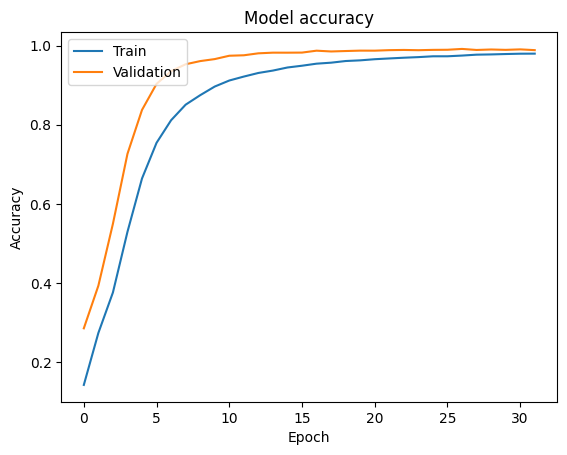

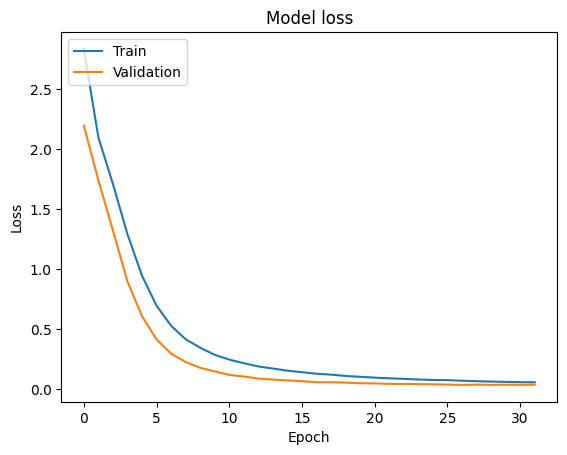

In [46]:
# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [47]:
y_pred = model.predict(X_test)

844/844 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


In [48]:
print(y_pred)

[[0.00000000e+00 1.88357766e-13 4.81873030e-06 ... 1.87719347e-13
  3.62596567e-16 1.64854608e-16]
 [0.00000000e+00 1.05394080e-33 7.64669439e-10 ... 5.47412512e-16
  1.59888669e-17 1.46490429e-19]
 [0.00000000e+00 0.00000000e+00 6.32528432e-30 ... 2.39469166e-27
  1.00315865e-02 9.89802182e-01]
 ...
 [0.00000000e+00 5.90991700e-19 2.05298225e-18 ... 1.72899307e-21
  2.26448597e-23 1.08548475e-23]
 [0.00000000e+00 0.00000000e+00 8.15609289e-30 ... 2.61822465e-30
  3.55464175e-26 1.21269798e-29]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [49]:
predicted_slots = np.argmax(y_pred, axis=1)

In [50]:
print(predicted_slots)

[ 6  6 27 ...  9 12 20]


In [51]:
slot_labels = [f'slot_{i+1}' for i in range(28)]  # e.g., 'slot_1', 'slot_2', ..., 'slot_28'
predicted_slot_labels = [slot_labels[i] for i in predicted_slots]

In [52]:
y_test

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 1.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [53]:
# If y_test is one-hot encoded, convert it to class labels
y_test_labels = np.argmax(y_test, axis=1)
print(y_test_labels)

[ 6  6 27 ...  9 12 20]


In [54]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_test_labels, predicted_slots)
print(f"Accuracy: {accuracy:.4f}")

Accuracy: 0.9899


In [55]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test_labels, predicted_slots)
print(cm)

[[ 608    0    0    0    0    0    0    0    0    0    0    2    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0]
 [   0  762    6    2    0    0    0    1    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    2    0    0    0]
 [   0    2  983    6    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    1    0]
 [   0    0    7  843    5    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0]
 [   0    0    0    5  858    2    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    1]
 [   0    0    0    0    0 1065    6    2    0    0    0    0    0    1
     0    0    0    0    0    0    0    0    0    0    0    0    0    0]
 [   0    0    0    0    0    4 1107    7    0    0    0    0    0    0
     0    0    0    0    0    0    0    0    0    0    0  

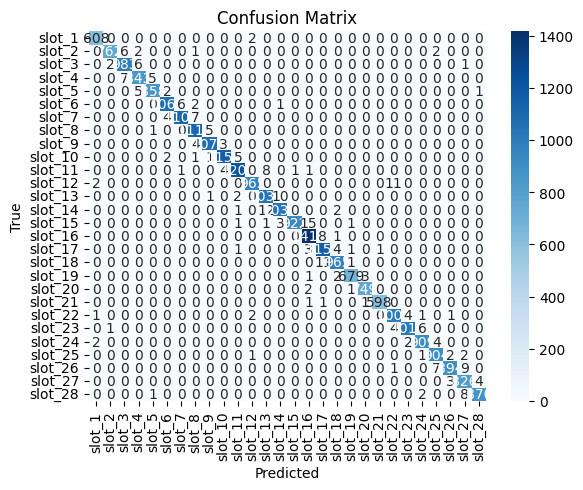

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=slot_labels, yticklabels=slot_labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [57]:
slot_labels = [f'slot_{i+1}' for i in range(28)]
predicted_slot_labels = [slot_labels[i] for i in predicted_slots]
print(predicted_slot_labels)

['slot_7', 'slot_7', 'slot_28', 'slot_9', 'slot_8', 'slot_8', 'slot_6', 'slot_25', 'slot_7', 'slot_23', 'slot_25', 'slot_17', 'slot_23', 'slot_26', 'slot_27', 'slot_12', 'slot_10', 'slot_6', 'slot_12', 'slot_25', 'slot_19', 'slot_25', 'slot_7', 'slot_19', 'slot_5', 'slot_21', 'slot_20', 'slot_14', 'slot_16', 'slot_5', 'slot_5', 'slot_26', 'slot_22', 'slot_2', 'slot_6', 'slot_2', 'slot_12', 'slot_13', 'slot_18', 'slot_4', 'slot_17', 'slot_28', 'slot_16', 'slot_18', 'slot_6', 'slot_10', 'slot_11', 'slot_5', 'slot_17', 'slot_21', 'slot_20', 'slot_22', 'slot_17', 'slot_13', 'slot_23', 'slot_22', 'slot_19', 'slot_22', 'slot_16', 'slot_2', 'slot_4', 'slot_28', 'slot_6', 'slot_2', 'slot_23', 'slot_3', 'slot_8', 'slot_8', 'slot_25', 'slot_24', 'slot_6', 'slot_10', 'slot_10', 'slot_14', 'slot_3', 'slot_28', 'slot_16', 'slot_4', 'slot_26', 'slot_3', 'slot_9', 'slot_10', 'slot_17', 'slot_26', 'slot_9', 'slot_14', 'slot_2', 'slot_22', 'slot_20', 'slot_17', 'slot_6', 'slot_5', 'slot_5', 'slot_10', 

In [58]:
from tensorflow.keras.activations import softmax

In [59]:
print(f"y_pred shape: {y_pred.shape}")

y_pred shape: (27001, 28)


In [60]:
y_pred = np.array(y_pred, dtype=np.float32)
y_pred_probabilities = softmax(y_pred, axis=1)

In [61]:
sorted_probabilities = np.sort(y_pred_probabilities, axis=1)[:, ::-1]

In [62]:
sorted_classes = np.argsort(y_pred_probabilities, axis=1)[:, ::-1]

In [63]:
print(sorted_classes)

[[ 6  2  7 ...  3  1  0]
 [ 6  7 10 ...  2  1  0]
 [27 26 23 ...  2  1  0]
 ...
 [ 9 10 14 ...  2  1  0]
 [12 13 16 ...  2  1  0]
 [20 16 17 ...  2  1  0]]


In [64]:
slot_names = [f"slot_{i+1}" for i in range(28)]
sorted_slot_names = [[slot_names[i] for i in indices] for indices in sorted_classes]

In [65]:
print(sorted_slot_names)

[['slot_7', 'slot_3', 'slot_8', 'slot_6', 'slot_11', 'slot_24', 'slot_22', 'slot_23', 'slot_28', 'slot_27', 'slot_26', 'slot_25', 'slot_17', 'slot_18', 'slot_19', 'slot_20', 'slot_21', 'slot_16', 'slot_14', 'slot_15', 'slot_9', 'slot_10', 'slot_12', 'slot_13', 'slot_5', 'slot_4', 'slot_2', 'slot_1'], ['slot_7', 'slot_8', 'slot_11', 'slot_9', 'slot_24', 'slot_23', 'slot_22', 'slot_21', 'slot_28', 'slot_27', 'slot_26', 'slot_25', 'slot_17', 'slot_18', 'slot_19', 'slot_20', 'slot_13', 'slot_14', 'slot_16', 'slot_15', 'slot_10', 'slot_12', 'slot_6', 'slot_5', 'slot_4', 'slot_3', 'slot_2', 'slot_1'], ['slot_28', 'slot_27', 'slot_24', 'slot_26', 'slot_25', 'slot_23', 'slot_22', 'slot_21', 'slot_20', 'slot_19', 'slot_18', 'slot_17', 'slot_16', 'slot_15', 'slot_14', 'slot_13', 'slot_12', 'slot_11', 'slot_10', 'slot_9', 'slot_8', 'slot_7', 'slot_6', 'slot_5', 'slot_4', 'slot_3', 'slot_2', 'slot_1'], ['slot_9', 'slot_14', 'slot_8', 'slot_10', 'slot_13', 'slot_11', 'slot_24', 'slot_23', 'slot_28'

In [66]:
print(sorted_slot_names[:10])

[['slot_7', 'slot_3', 'slot_8', 'slot_6', 'slot_11', 'slot_24', 'slot_22', 'slot_23', 'slot_28', 'slot_27', 'slot_26', 'slot_25', 'slot_17', 'slot_18', 'slot_19', 'slot_20', 'slot_21', 'slot_16', 'slot_14', 'slot_15', 'slot_9', 'slot_10', 'slot_12', 'slot_13', 'slot_5', 'slot_4', 'slot_2', 'slot_1'], ['slot_7', 'slot_8', 'slot_11', 'slot_9', 'slot_24', 'slot_23', 'slot_22', 'slot_21', 'slot_28', 'slot_27', 'slot_26', 'slot_25', 'slot_17', 'slot_18', 'slot_19', 'slot_20', 'slot_13', 'slot_14', 'slot_16', 'slot_15', 'slot_10', 'slot_12', 'slot_6', 'slot_5', 'slot_4', 'slot_3', 'slot_2', 'slot_1'], ['slot_28', 'slot_27', 'slot_24', 'slot_26', 'slot_25', 'slot_23', 'slot_22', 'slot_21', 'slot_20', 'slot_19', 'slot_18', 'slot_17', 'slot_16', 'slot_15', 'slot_14', 'slot_13', 'slot_12', 'slot_11', 'slot_10', 'slot_9', 'slot_8', 'slot_7', 'slot_6', 'slot_5', 'slot_4', 'slot_3', 'slot_2', 'slot_1'], ['slot_9', 'slot_14', 'slot_8', 'slot_10', 'slot_13', 'slot_11', 'slot_24', 'slot_23', 'slot_28'

In [122]:
import pandas as pd
pd.DataFrame(sorted_slot_names).head(20)

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,slot_7,slot_3,slot_8,slot_6,slot_11,slot_24,slot_22,slot_23,slot_28,slot_27,...,slot_14,slot_15,slot_9,slot_10,slot_12,slot_13,slot_5,slot_4,slot_2,slot_1
1,slot_7,slot_8,slot_11,slot_9,slot_24,slot_23,slot_22,slot_21,slot_28,slot_27,...,slot_16,slot_15,slot_10,slot_12,slot_6,slot_5,slot_4,slot_3,slot_2,slot_1
2,slot_28,slot_27,slot_24,slot_26,slot_25,slot_23,slot_22,slot_21,slot_20,slot_19,...,slot_10,slot_9,slot_8,slot_7,slot_6,slot_5,slot_4,slot_3,slot_2,slot_1
3,slot_9,slot_14,slot_8,slot_10,slot_13,slot_11,slot_24,slot_23,slot_28,slot_27,...,slot_16,slot_15,slot_12,slot_7,slot_6,slot_5,slot_4,slot_3,slot_2,slot_1
4,slot_8,slot_9,slot_13,slot_5,slot_4,slot_24,slot_22,slot_23,slot_28,slot_27,...,slot_15,slot_16,slot_10,slot_11,slot_12,slot_7,slot_6,slot_3,slot_2,slot_1
5,slot_8,slot_9,slot_13,slot_5,slot_4,slot_24,slot_22,slot_23,slot_28,slot_27,...,slot_15,slot_16,slot_10,slot_11,slot_12,slot_7,slot_6,slot_3,slot_2,slot_1
6,slot_6,slot_5,slot_2,slot_28,slot_24,slot_23,slot_22,slot_21,slot_20,slot_27,...,slot_14,slot_13,slot_9,slot_10,slot_11,slot_7,slot_8,slot_4,slot_3,slot_1
7,slot_25,slot_26,slot_12,slot_22,slot_24,slot_27,slot_23,slot_2,slot_20,slot_19,...,slot_10,slot_15,slot_9,slot_8,slot_6,slot_7,slot_5,slot_4,slot_3,slot_1
8,slot_7,slot_8,slot_3,slot_4,slot_11,slot_9,slot_24,slot_23,slot_28,slot_27,...,slot_16,slot_15,slot_10,slot_12,slot_14,slot_13,slot_5,slot_6,slot_2,slot_1
9,slot_23,slot_24,slot_27,slot_28,slot_25,slot_26,slot_22,slot_21,slot_20,slot_19,...,slot_10,slot_9,slot_8,slot_7,slot_6,slot_5,slot_4,slot_3,slot_2,slot_1


In [68]:
model.save('model.h5')

In [69]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

In [70]:
test_action_history = pd.read_csv("test_action_history.csv")
test_cdna_data = pd.read_csv("test_cdna_data.csv")
test_customers = pd.read_csv("test_customers.csv")

In [71]:
test_cdna_data['batch_date'] = pd.to_datetime(test_cdna_data['batch_date'], utc=True)  
test_action_history['send_timestamp'] = pd.to_datetime(test_action_history['send_timestamp'], utc=True)

In [72]:
test_action_history.rename(columns={"customer_code": "CUSTOMER_CODE"}, inplace=True)

In [73]:
merged_cdna_action = pd.merge(test_cdna_data, test_action_history, on="CUSTOMER_CODE", how="inner")

In [74]:
filtered_cdna_action = merged_cdna_action[merged_cdna_action['batch_date'] <= merged_cdna_action['send_timestamp']]

In [75]:
latest_cdna_per_customer = filtered_cdna_action.loc[
    filtered_cdna_action.groupby('CUSTOMER_CODE')['batch_date'].idxmax()
]

In [76]:
final_merged_data = pd.merge(test_customers, latest_cdna_per_customer, on="CUSTOMER_CODE", how="left")

In [77]:
final_merged_data.head(20)

,CUSTOMER_CODE,v2,v3,v4,v5,v6,v7,v8,v9,v10,...,v301,v302,batch_date,Offer_id,Offer_subid,batch_id,product_category,product_sub_category,send_timestamp,open_timestamp
0,2cf9e9b31ca760b8772d8e136e85c640df36b491ba8be7...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN
1,34481740a44eae239d61c7c0526dc42dc221a94939a8c1...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN
2,bb5d102bb50fd308aee248d0fa5cdddbf1a29e263d8e2d...,25-29,NaN,NaN,99,Coimbatore,95013,NaN,INDIA,IN,...,233.0,309.0,2024-11-29 00:00:00+00:00,AC_100046160,VR_200107992,20000244.0,SAVINGS,TURBO-SA XSELL,2024-11-30 15:03:31+00:00,2024-11-30T15:33:29.000Z
3,8229cb51e7392dc37cac4fd94959699bca2c9424a8548c...,45-49,NaN,NaN,99,LUCKNOW,99999,NaN,INDIA,IN,...,233.0,309.0,2024-11-29 00:00:00+00:00,AC_100047624,VR_200110558,20000244.0,ASSETS,EDUCATION LOAN FRESH,2024-11-29 16:05:44+00:00,2024-11-29T16:49:39.000Z
4,f812ad81bc6939bab1856476f12ee2ff8100b8308a3b1c...,30-34,NaN,NaN,NaN,JODHPUR,NaN,NaN,NaN,356,...,233.0,309.0,2024-11-29 00:00:00+00:00,AC_100053429,VR_200134435,70000085.0,CC_INORGANIC,BALANCE_TRANSFER,2024-11-29 11:53:37+00:00,2024-11-29T17:07:00.000Z
5,6d00a995eeb6a992c5452ffff78f9fadfbfd22b4c8d2eb...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN
6,9bdcf8cf9e6df4bc9894a09ee53043d8bfe85a2448dde3...,45-49,NaN,NaN,99,WEST DELHI,99999,NaN,INDIA,IN,...,233.0,309.0,2024-11-29 00:00:00+00:00,AC_100053542,VR_200138205,70000085.0,CC_SPENDS,PORTFOLIO,2024-11-29 16:42:18+00:00,NaN
7,82b849f855eaacaf3cf4092b454d26cb502b779a67e914...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN
8,df0ad7c5cc4aacbf73275608efa9e5573855b6fd5a6a6a...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN
9,bb28d91ebcef977b7c55c461da57c0523fad3f16a46dbc...,50-54,NaN,NaN,NaN,SURAT,NaN,NaN,IN,356,...,233.0,309.0,2024-11-29 00:00:00+00:00,AC_100053429,VR_200134435,70000085.0,CC_INORGANIC,BALANCE_TRANSFER,2024-11-29 18:28:22+00:00,2024-11-30T12:09:54.000Z


In [78]:
final_merged_data.shape

(65708, 310)

In [79]:
final_merged_data['send_timestamp'] = pd.to_datetime(final_merged_data['send_timestamp'], errors='coerce')
final_merged_data['open_timestamp'] = pd.to_datetime(final_merged_data['open_timestamp'], errors='coerce')

In [80]:
final_merged_data['send_slot'] = final_merged_data['send_timestamp'].apply(calculate_slot)
final_merged_data['open_slot'] = final_merged_data['open_timestamp'].apply(calculate_slot)

In [81]:
all_nan_cols = final_merged_data.columns[final_merged_data.isna().all()]

print(all_nan_cols)

Index(['v3', 'v4', 'v8', 'v12', 'v13', 'v14', 'v21', 'v22', 'v23', 'v25',
       'v26', 'v28', 'v57', 'v70', 'v75', 'v76', 'v78', 'v149', 'v150', 'v151',
       'v152', 'v153', 'v154', 'v214', 'v221', 'v242', 'v245', 'v246', 'v247',
       'v248', 'v249', 'v250', 'v251'],
      dtype='object')


In [82]:
x = final_merged_data.drop(columns=['open_slot', 'CUSTOMER_CODE'])

In [83]:
x.shape

(65708, 310)

In [84]:
# Extract useful components from datetime columns
x['send_hour'] = x['send_timestamp'].dt.hour
x['send_day'] = x['send_timestamp'].dt.day
x['send_weekday'] = x['send_timestamp'].dt.weekday

x['open_hour'] = x['open_timestamp'].dt.hour
x['open_day'] = x['open_timestamp'].dt.day
x['open_weekday'] = x['open_timestamp'].dt.weekday

x['batch_hour'] = x['batch_date'].dt.hour
x['batch_day'] = x['batch_date'].dt.day
x['batch_weekday'] = x['batch_date'].dt.weekday

# Drop the original datetime columns if not needed
x = x.drop(columns=['send_timestamp', 'open_timestamp', 'batch_date'])

In [85]:
non_numeric_columns = x.select_dtypes(include=['object']).columns
print("Non-numeric columns:", non_numeric_columns)

Non-numeric columns: Index(['v2', 'v5', 'v6', 'v7', 'v9', 'v10', 'v11', 'v15', 'v16', 'v17', 'v18',
       'v19', 'v20', 'v27', 'v29', 'v30', 'v31', 'v33', 'v34', 'v35', 'v36',
       'v37', 'v38', 'v39', 'v40', 'v41', 'v42', 'v43', 'v45', 'v46', 'v47',
       'v48', 'v49', 'v50', 'v51', 'v52', 'v53', 'v54', 'v55', 'v56', 'v57',
       'v58', 'v59', 'v60', 'v61', 'v63', 'v64', 'v66', 'v67', 'v68', 'v69',
       'v71', 'v72', 'v73', 'v74', 'v81', 'v99', 'v101', 'v102', 'v103',
       'v222', 'v223', 'v229', 'v230', 'v271', 'v272', 'v273', 'v274', 'v275',
       'v276', 'v277', 'v278', 'v279', 'v280', 'v281', 'v282', 'v283', 'v284',
       'v285', 'v286', 'Offer_id', 'Offer_subid', 'product_category',
       'product_sub_category', 'send_slot'],
      dtype='object')


In [86]:
for col in non_numeric_columns:
    print(f"Column: {col}")
    print(x[col].unique())
    print(x[col].dtype)

Column: v2
[nan '25-29' '45-49' '30-34' '50-54' '80-84' '35-39' '40-44' '60-64'
 '65-69' '20-24' '55-59' '70-74' '15-19' '75-79' '85-89' '10-14' '90-94'
 '95-99' '0-4']
object
Column: v5
[nan '99' 'ZZ' '49' '45' '05' '31' '41' '11' '42' 'UNSIC' '5']
object
Column: v6
[nan 'Coimbatore' 'LUCKNOW' ... 'KONDAGAON' 'PAPATOETOE' 'RIGGI']
object
Column: v7
[nan '95013' '99999' 'ZZ' '95012' '95019' '01201' '51201' '95014' '91101'
 '01' '95003' '01101' '74101' '95011' '51405' '93003' '02' '15' '0'
 '60101' '05' '51302' '52313' '06' '93002' '60204' '85102' '28901' '52319'
 '35909' '18101' '51406' '71201' '03' '93001' '95002' '51404' '60301'
 '51909' '15409' '93109' '26101' '29101A' '65929' '31901' '63012' '74301'
 '42' '85101' '04' '52101' '36909' '95001' '27201' '22101' '36907' '29202'
 '55201' '75001' '51301' '15502' '15201' '50002' '80001' '65923' '95009'
 '45012D' '20101' '52501' '17209B' '01103' '51202' '17209' '28101' '41001'
 '17105']
object
Column: v9
[nan 'INDIA' 'IN' 'India' 'UNITED KI

In [87]:
label_encoder = LabelEncoder()
for col in non_numeric_columns:
    x[col] = x[col].astype(str)
    x[col] = label_encoder.fit_transform(x[col])

In [88]:
x = x.fillna(x.mean())

In [89]:
np.isnan(x)

,v2,v3,v4,v5,v6,v7,v8,v9,v10,v11,...,send_slot,send_hour,send_day,send_weekday,open_hour,open_day,open_weekday,batch_hour,batch_day,batch_weekday
0,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65703,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
65704,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
65705,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
65706,False,True,True,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [90]:
x = x.drop(columns=['v3', 'v4', 'v8', 'v12', 'v13', 'v14', 'v21', 'v22', 'v23', 'v25',
       'v26', 'v28', 'v57', 'v70', 'v75', 'v76', 'v78', 'v149', 'v150', 'v151',
       'v152', 'v153', 'v154', 'v214', 'v221', 'v242', 'v245', 'v246', 'v247',
       'v248', 'v249', 'v250', 'v251'])

In [91]:
np.isnan(x)

,v2,v5,v6,v7,v9,v10,v11,v15,v16,v17,...,send_slot,send_hour,send_day,send_weekday,open_hour,open_day,open_weekday,batch_hour,batch_day,batch_weekday
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65703,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
65704,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
65705,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
65706,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [92]:
scaler = StandardScaler()
x = scaler.fit_transform(x)

In [93]:
x.shape

(65708, 283)

In [104]:
model = keras.models.load_model("model.h5")

In [108]:
y_pred_test = model.predict(x)

2054/2054 ━━━━━━━━━━━━━━━━━━━━ 2s 860us/step


In [109]:
print(y_pred_test)

predicted_slots_test = np.argmax(y_pred_test, axis=1)

slot_labels_test = [f'slot_{i+1}' for i in range(28)] 
predicted_slot_labels_test = [slot_labels_test[i] for i in predicted_slots_test]

print(predicted_slot_labels_test)

[[3.2962990e-19 2.2972185e-04 7.3966649e-03 ... 2.6209725e-06
  2.5876437e-07 2.5079419e-07]
 [3.2962990e-19 2.2972185e-04 7.3966649e-03 ... 2.6209725e-06
  2.5876437e-07 2.5079419e-07]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [3.2962990e-19 2.2972185e-04 7.3966649e-03 ... 2.6209725e-06
  2.5876437e-07 2.5079419e-07]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [9.9104703e-21 3.8545040e-06 3.2085285e-03 ... 5.5454702e-06
  5.0036506e-06 6.7037217e-07]]
['slot_7', 'slot_7', 'slot_19', 'slot_22', 'slot_22', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_17', 'slot_1', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_15', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_7', 'slot_10', 'slot_7', 'slot_7', 'slot_1', 'slot_7', 'slot_17', 'slot_7', 'slot_7', 'slot_7', 'slot_7'

In [110]:
print(f"y_pred_test shape: {y_pred_test.shape}")

y_pred_test shape: (65708, 28)


In [112]:
y_pred_test = np.array(y_pred_test, dtype=np.float32)
y_pred_probabilities_test = softmax(y_pred_test, axis=1)

In [113]:
sorted_probabilities_test = np.sort(y_pred_probabilities_test, axis=1)[:, ::-1]

In [114]:
sorted_classes_test = np.argsort(y_pred_probabilities_test, axis=1)[:, ::-1]

In [115]:
print(sorted_classes_test)

[[ 6  5  2 ... 13 14  0]
 [ 6  5  2 ... 13 14  0]
 [18 17 19 ...  2  1  0]
 ...
 [ 6  5  2 ... 13 14  0]
 [20 17 27 ...  2  1  0]
 [ 6  7  5 ... 13 14  0]]


In [117]:
slot_names_test = [f"slot_{i+1}" for i in range(28)]
sorted_slot_names_test = [[slot_names_test[i] for i in indices] for indices in sorted_classes_test]

In [118]:
print(sorted_slot_names_test)

[['slot_7', 'slot_6', 'slot_3', 'slot_8', 'slot_4', 'slot_5', 'slot_11', 'slot_2', 'slot_10', 'slot_9', 'slot_26', 'slot_13', 'slot_25', 'slot_27', 'slot_28', 'slot_16', 'slot_21', 'slot_22', 'slot_23', 'slot_24', 'slot_17', 'slot_18', 'slot_19', 'slot_20', 'slot_12', 'slot_14', 'slot_15', 'slot_1'], ['slot_7', 'slot_6', 'slot_3', 'slot_8', 'slot_4', 'slot_5', 'slot_11', 'slot_2', 'slot_10', 'slot_9', 'slot_26', 'slot_13', 'slot_25', 'slot_27', 'slot_28', 'slot_16', 'slot_21', 'slot_22', 'slot_23', 'slot_24', 'slot_17', 'slot_18', 'slot_19', 'slot_20', 'slot_12', 'slot_14', 'slot_15', 'slot_1'], ['slot_19', 'slot_18', 'slot_20', 'slot_28', 'slot_25', 'slot_26', 'slot_27', 'slot_24', 'slot_21', 'slot_22', 'slot_23', 'slot_17', 'slot_16', 'slot_15', 'slot_14', 'slot_13', 'slot_12', 'slot_11', 'slot_10', 'slot_9', 'slot_8', 'slot_7', 'slot_6', 'slot_5', 'slot_4', 'slot_3', 'slot_2', 'slot_1'], ['slot_22', 'slot_28', 'slot_26', 'slot_27', 'slot_25', 'slot_24', 'slot_23', 'slot_21', 'slot_2

In [119]:
prediction = pd.DataFrame({
    'Customer_code': test_customers['CUSTOMER_CODE'],
    'predicted_slots_order': sorted_slot_names_test
})

In [120]:
prediction

,Customer_code,predicted_slots_order
0,2cf9e9b31ca760b8772d8e136e85c640df36b491ba8be7...,"[slot_7, slot_6, slot_3, slot_8, slot_4, slot_..."
1,34481740a44eae239d61c7c0526dc42dc221a94939a8c1...,"[slot_7, slot_6, slot_3, slot_8, slot_4, slot_..."
2,bb5d102bb50fd308aee248d0fa5cdddbf1a29e263d8e2d...,"[slot_19, slot_18, slot_20, slot_28, slot_25, ..."
3,8229cb51e7392dc37cac4fd94959699bca2c9424a8548c...,"[slot_22, slot_28, slot_26, slot_27, slot_25, ..."
4,f812ad81bc6939bab1856476f12ee2ff8100b8308a3b1c...,"[slot_22, slot_23, slot_28, slot_27, slot_25, ..."
...,...,...
65703,2b3f8f3a6222d12e94cb7ca4911472464ad36b80b506e0...,"[slot_7, slot_6, slot_3, slot_8, slot_4, slot_..."
65704,1763f89ffbb619f67b5614da85f2e6e2d37702420c893d...,"[slot_7, slot_6, slot_8, slot_11, slot_5, slot..."
65705,6ad50ea3f7b58bda52c7a7e52c2f10880cd27e8742dcb7...,"[slot_7, slot_6, slot_3, slot_8, slot_4, slot_..."
65706,08f86635d836ffaba3b30df970e2ea7fb6c2116d4619ef...,"[slot_21, slot_18, slot_28, slot_27, slot_25, ..."


In [121]:
# Save the predictions to a CSV file (optional)
prediction.to_csv('Predictions_Output.csv', index=False)
print("Predictions saved to file.")

Predictions saved to file.
